# clip by VLM

/tmp/ipykernel_1036745/1661926486.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  simis = torch.load('/root/videollm-online/all_simis_9.pt')


494


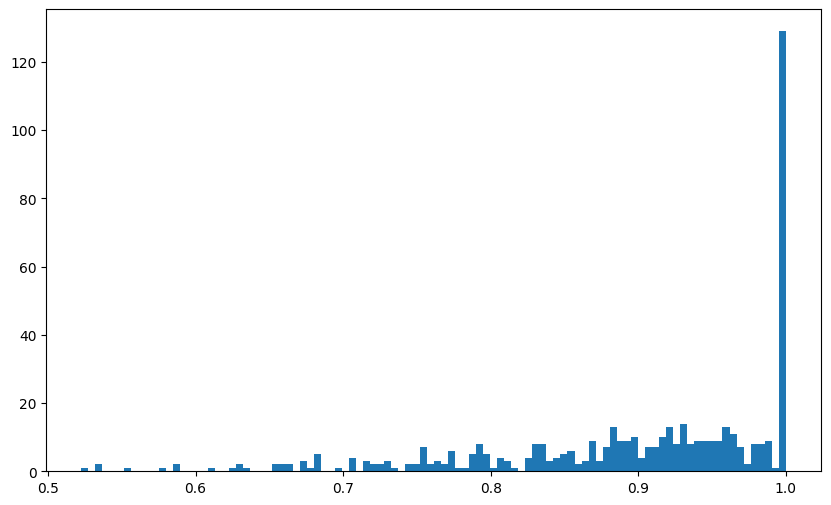

In [1]:
import torch
import matplotlib.pyplot as plt

simis = torch.load('/root/videollm-online/all_simis_9.pt')
print(len(simis))
plt.figure(figsize=(10, 6))
plt.hist(simis, bins=100)
plt.savefig('/root/videollm-online/simis.png')


# clip by constant

In [2]:
import json
import os
import tqdm


anno_data = json.load(open('/root/videollm-online/datasets/ego4d/v2/annotations/refined_narration_stream_train.json'))
anno_data_val = json.load(open('/root/videollm-online/datasets/ego4d/v2/annotations/refined_narration_stream_val.json'))
anno_data = {**anno_data, **anno_data_val}

origin_narration = json.load(open("/root/videollm-online/datasets/ego4d/v2/annotations/all_narrations_redacted.json"))['videos']

In [3]:
# compute the beta and alpha values
beta_map = {}
for video_uid, _annotation_uid_narrations in tqdm.tqdm(anno_data.items()):
    for annotation_uid, narrations in _annotation_uid_narrations.items():
        total_time = 0
        if len(narrations) == 0:
            continue
        for i, narration in enumerate(narrations):
            if i == len(narrations) - 1:
                break
            total_time += (narrations[i+1]['time'] - narrations[i]['time'])
        beta_map[annotation_uid] = total_time / len(narrations)

alpha_map = sum(beta_map.values()) / len(beta_map)
print(alpha_map)


100%|██████████| 8631/8631 [00:02<00:00, 3843.80it/s]

8.51727449052551


In [4]:
import pandas as pd

metadata = pd.read_csv('/root/videollm-online/datasets/egoclip/egoclip.csv', sep='\t', on_bad_lines='skip')
""" ====================================== EGOVLP ==============================================="""
# frame_fps = 2
# VIDEO_ROOT = '/root/videollm-online/datasets/ego4d/v2/full_scale_2fps_max384'
# row_id = 0
# path = metadata['video_uid'][row_id]

# stamp_time = metadata['narration_time'][row_id]
# start_time = metadata['clip_start'][row_id] - 1
# end_time = metadata['clip_end'][row_id] + 2
# action_narration = metadata['clip_text'][row_id]


In [3]:
clip_idx = 1
action_idx = 3
path = '078b33d5-2f4c-40a1-b710-cdd368a19ff0'

## load action clip

In [4]:
import decord
from decord import VideoReader
import numpy as np
import os
decord.bridge.set_bridge("torch")
import math
from PIL import Image

def ceil_time_by_fps(time: float, fps: int, min_time: float, max_time: float):
    return min(max(math.ceil(time * fps) / fps, min_time), max_time)


def action2clip(path, clip_idx, action_idx, alpha=4.9):
    
    clip_id = list(anno_data[path].keys())[clip_idx]
    stamp_time = anno_data[path][clip_id][action_idx]['time']
    start_time = stamp_time - beta_map[clip_id] / (2*alpha)
    end_time = stamp_time + beta_map[clip_id] / (2*alpha)
    
    return stamp_time, start_time, end_time, clip_id

def load_action_clip(path, clip_idx, action_idx):
    frame_fps = 2
    VIDEO_ROOT = '/root/videollm-online/datasets/ego4d/v2/full_scale_2fps'
    stamp_time, start_time, end_time, clip_id = action2clip(path, clip_idx, action_idx)
    action_narration = anno_data[path][clip_id][action_idx]['text']

    vr = VideoReader(uri=os.path.join(VIDEO_ROOT, path) + '.mp4')
    load_range = range(int(ceil_time_by_fps(start_time, frame_fps, 0, vr._num_frame / frame_fps) * frame_fps), int(ceil_time_by_fps(end_time, frame_fps, 0, vr._num_frame / frame_fps)* frame_fps) + 1)
    frames = vr.get_batch(load_range)
    frames = [Image.fromarray(v.astype('uint8')) for v in frames.numpy()]
    
    return action_narration, frames, stamp_time, start_time, end_time, load_range


# clip_idx = 1
# action_idx = 3
# path = '078b33d5-2f4c-40a1-b710-cdd368a19ff0'
# action_narration, frames, stamp_time, start_time, end_time, load_range = load_action_clip(path, clip_idx, action_idx)




## clip video by action

In [5]:
import decord
from decord import VideoReader
import numpy as np
import os
decord.bridge.set_bridge("torch")
import math

def ceil_time_by_fps(time: float, fps: int, min_time: float, max_time: float):
    return min(max(math.ceil(time * fps) / fps, min_time), max_time)

def sentence2token(sentence):
    a = sentence.split()
    return a

def flatten_list(nested_list):
    result = []
    for sublist in nested_list:
        result.extend(sublist)
    return result

violent_action = [['cross'],['drive', 'ride'], ['enter'], ['walk'], ['step']]
violent_action = flatten_list(violent_action)
slight_action = [['kneel', 'lay', 'lays', 'sit'], ['stand'], ['check', 'compare', 'examine', 'inspect', 'look', 'observe', 'see', 'view']]
slight_action = flatten_list(slight_action)

def is_violent_action(scentence):
    for action in violent_action:
        if action in sentence2token(scentence):
            return True
    return False

def is_slight_action(scentence):
    for action in slight_action:
        if action in sentence2token(scentence):
            return True
    return False

def clip2scene(clip_idx, path):
    clip_id = list(anno_data[path].keys())[clip_idx]
    narrations = anno_data[path][clip_id]
    clip_list = []
    start_idx = 0
    if len(narrations) == 0:
        return []
    for action_idx, narration in enumerate(narrations):
        if is_violent_action(narration['text']) and action_idx != len(narrations) - 1 and (narrations[action_idx+1]['time'] - narration['time']) > 5:
            _, start_time1, end_time1, _ = action2clip(path, clip_idx, start_idx)
            _, start_time2, end_time2, _ = action2clip(path, clip_idx, action_idx)
            
            clip_list.append((start_time1, start_time2))
            start_idx = action_idx + 1
            
            _, start_time3, end_time3, _ = action2clip(path, clip_idx, action_idx, alpha=2.5)
            _, start_time4, end_time4, _ = action2clip(path, clip_idx, start_idx) if start_idx < len(narrations) else action2clip(path, clip_idx, action_idx)
            clip_list.append((start_time3, max(start_time4, end_time4)))
            
        elif action_idx == len(narrations) - 1:
            _, start_time1, end_time1, _ = action2clip(path, clip_idx, start_idx)
            _, start_time2, end_time2, _ = action2clip(path, clip_idx, action_idx)
            clip_list.append((start_time1, start_time2))
    
    return clip_list
            

def load_scene_clip(path, clip_idx, max_frame=32):
    frame_fps = 2
    VIDEO_ROOT = '/root/videollm-online/datasets/ego4d/v2/full_scale_2fps'
    clip_id = list(anno_data[path].keys())[clip_idx]
    
    clip_list = clip2scene(clip_idx, path)
    print(clip_list)
    for clips in clip_list:
        start_time, end_time = clips
        vr = VideoReader(uri=os.path.join(VIDEO_ROOT, path) + '.mp4')
        load_range = range(int(ceil_time_by_fps(start_time, frame_fps, 0, vr._num_frame / frame_fps) * frame_fps), int(ceil_time_by_fps(end_time, frame_fps, 0, vr._num_frame / frame_fps)* frame_fps) + 1)
        frames = vr.get_batch(load_range)
        frames = [Image.fromarray(v.astype('uint8')) for v in frames.numpy()]
        if len(frames) > max_frame:
            # uniformly sample frames
            frames = frames[::math.ceil(len(frames) / max_frame)]
            load_range = range(0,len(frames))
        yield frames, start_time, end_time, load_range


    
# clip_gen = load_scene_clip(path, clip_idx)

# frames, start_time, end_time, load_range = next(clip_gen)
    

## clip video by vision feature and fps

In [5]:
from siglip import visionTextAligner
aliger = visionTextAligner()
print('load model')

load model


In [9]:
def load_scene_clipv2(path, clip_idx, max_frame=32, ):
    frame_fps = 2
    VIDEO_ROOT = '/root/videollm-online/datasets/ego4d/v2/full_scale_2fps'
    clip_id = list(anno_data[path].keys())[clip_idx]
    
    # load clip
    summs = origin_narration[path]['summaries']
    for summ in summs:
        if summ['_annotation_uid'] == clip_id:
            break
    start_time, end_time = summ['start_time'], summ['end_time']
    vr = VideoReader(uri=os.path.join(VIDEO_ROOT, path) + '.mp4')
    load_range = range(int(ceil_time_by_fps(start_time, frame_fps, 0, vr._num_frame / frame_fps) * frame_fps), int(ceil_time_by_fps(end_time, frame_fps, 0, vr._num_frame / frame_fps)* frame_fps) + 1)
    frames = vr.get_batch(load_range)
    print(frames.shape)
    # vision simi
    simi = aliger.vision_simi(frames)
    print(simi)
    frames = vr.get_batch(load_range)
    frames = [Image.fromarray(v.astype('uint8')) for v in frames.numpy()]
    if simi > 0.8:
        if len(frames) > max_frame:
            # uniformly sample frames
            frames = frames[::math.ceil(len(frames) / max_frame)]
            load_range = range(0,len(frames))
            yield frames, start_time, end_time, load_range
    elif simi < 0.6:
        for i in range(0, len(frames), max_frame):
            r_f = frames[i:i+max_frame]
            yield r_f, start_time + i / frame_fps, start_time + (i + len(r_f)) / frame_fps, range(0,len(r_f))
    else:
        if len(frames) > max_frame:
            # uniformly sample frames
            frames = frames[::frame_fps*2]
        for i in range(0, len(frames), max_frame):
            r_f = frames[i:i+max_frame]
            yield r_f, start_time + i / frame_fps, start_time + (i + len(r_f)) / frame_fps, range(0,len(r_f))
    
clip_gen = load_scene_clipv2(path, clip_idx)


In [7]:
frames, start_time, end_time, load_range = next(clip_gen)

torch.Size([149, 1080, 1440, 3])
tensor(0.6999)


In [10]:
print(math.ceil(149 / (2 )))

75


In [8]:
print(len(frames))
print(start_time, end_time, load_range )

2
810.0033333333333 811.0033333333333 range(0, 2)


In [6]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import math
from PIL import Image

print(start_time, end_time)
print(load_range)


def show_image(load_range, frames, output_path=None):
    frames_per_row = 7

    # 计算行数
    rows = math.ceil(len(load_range) / frames_per_row)

    # 创建子图
    fig, axes = plt.subplots(rows, frames_per_row, figsize=(frames_per_row * 4, rows * 4))

    # 将 frames 绘制到子图中
    for i in range(len(load_range)):
        row = i // frames_per_row
        col = i % frames_per_row
        if rows == 1:
            axes[col].imshow(frames[i])
            axes[col].axis('off')
            axes[col].set_title(f"Frame {i}")
        else:
            axes[row, col].imshow(frames[i])
            axes[row, col].axis('off')
            axes[row, col].set_title(f"Frame {i}")

    # 如果最后一行有空的子图格子，关闭它们
    for i in range(len(load_range), rows * frames_per_row):
        fig.delaxes(axes.flatten()[i])

    if output_path is not None:
        plt.savefig(output_path)
    else:
        plt.tight_layout()
        plt.show()
    
show_image(load_range, frames)

# Caption clip

In [1]:
import torch
from PIL import Image
from transformers import AutoModel, AutoTokenizer

model = AutoModel.from_pretrained('openbmb/MiniCPM-V-2_6', trust_remote_code=True,
    attn_implementation='sdpa', torch_dtype=torch.bfloat16) # sdpa or flash_attention_2, no eager
model = model.eval().to('cuda:3')
tokenizer = AutoTokenizer.from_pretrained('openbmb/MiniCPM-V-2_6', trust_remote_code=True)



/root/miniconda3/envs/videollm/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Loading checkpoint shards: 100%|██████████| 4/4 [00:00<00:00,  8.31it/s]


In [7]:
def get_caption(model, tokenizer, action_narration, frames, prompt_file, scene_subject):
    if action_narration is None:
        question = open(prompt_file).read().format(scene_subject)
    else:
        question = open(prompt_file).read().format(action_narration.replace('You','I'), scene_subject)
    msgs = [
        {'role': 'user', 'content': frames + [question]}, 
    ]
    
    # Set decode params for video
    params={}
    params["use_image_id"] = False
    params["max_slice_nums"] = 2 # use 1 if cuda OOM and video resolution >  448*448

    answer = model.chat(
        image=None,
        msgs=msgs,
        tokenizer=tokenizer,
        **params
    )
    return question, answer

# question, answer = get_caption(model, tokenizer, action_narration, frames, 
#                                '/root/videollm-online/data/preprocess/caption/prompt_streamingbench.txt', 'Talking on the phone / Talking to colleagues')

# print(question)
# print(answer)

# batch extract

  0%|          | 0/121 [00:00<?, ?it/s]

torch.Size([61, 1920, 2560, 3])
tensor(0.8629)


/root/miniconda3/envs/videollm/lib/python3.10/site-packages/transformers/models/auto/image_processing_auto.py:513: FutureWarning: The image_processor_class argument is deprecated and will be removed in v4.42. Please use `slow_image_processor_class`, or `fast_image_processor_class` instead
  warnings.warn(
  1%|          | 1/121 [02:31<5:02:45, 151.38s/it]

torch.Size([602, 1440, 1920, 3])
tensor(0.6213)


  2%|▏         | 2/121 [07:43<8:08:02, 246.07s/it]

torch.Size([601, 1440, 1920, 3])
tensor(0.7155)


  2%|▏         | 3/121 [13:02<9:08:58, 279.14s/it]

torch.Size([256, 1440, 1920, 3])
tensor(0.6153)


  3%|▎         | 4/121 [15:16<7:12:36, 221.85s/it]

torch.Size([600, 1080, 1440, 3])
tensor(0.6584)


  4%|▍         | 5/121 [20:07<7:57:06, 246.78s/it]

torch.Size([362, 1080, 1920, 3])
tensor(0.6902)


/tmp/ipykernel_3290930/2983587302.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(rows, frames_per_row, figsize=(frames_per_row * 4, rows * 4))
  5%|▍         | 6/121 [23:10<7:11:37, 225.20s/it]

torch.Size([601, 1440, 1920, 3])
tensor(0.6081)


  6%|▌         | 7/121 [28:26<8:03:58, 254.73s/it]

torch.Size([218, 1440, 1920, 3])
tensor(0.6483)


  7%|▋         | 8/121 [30:23<6:37:16, 210.94s/it]

torch.Size([60, 1440, 2880, 3])
tensor(0.8930)


  7%|▋         | 9/121 [31:11<4:58:39, 160.00s/it]

torch.Size([601, 1080, 1920, 3])
tensor(0.4210)


  8%|▊         | 10/121 [41:22<9:13:45, 299.33s/it]

torch.Size([196, 1080, 1440, 3])
tensor(0.7127)


  9%|▉         | 11/121 [42:51<7:10:52, 235.02s/it]

torch.Size([61, 1080, 1920, 3])
tensor(0.8929)


 10%|▉         | 12/121 [43:33<5:19:53, 176.09s/it]

torch.Size([601, 1440, 1920, 3])
tensor(0.7964)


 11%|█         | 13/121 [48:29<6:22:49, 212.68s/it]

torch.Size([601, 1080, 1440, 3])
tensor(0.7213)


 12%|█▏        | 14/121 [53:14<6:57:47, 234.28s/it]

torch.Size([60, 1080, 1920, 3])
tensor(0.6712)


 12%|█▏        | 15/121 [53:49<5:07:59, 174.33s/it]

torch.Size([601, 1080, 1920, 3])
tensor(0.4473)


 13%|█▎        | 16/121 [1:03:54<8:52:05, 304.05s/it]

torch.Size([601, 1080, 1440, 3])
tensor(0.5337)


 14%|█▍        | 17/121 [1:13:32<11:09:28, 386.24s/it]

torch.Size([601, 1080, 1920, 3])
tensor(0.6753)


 15%|█▍        | 18/121 [1:18:04<10:04:04, 351.89s/it]

torch.Size([600, 1080, 1440, 3])
tensor(0.6854)


 16%|█▌        | 19/121 [1:22:22<9:10:38, 323.91s/it] 

torch.Size([199, 1080, 1440, 3])
tensor(0.7239)


 17%|█▋        | 20/121 [1:23:56<7:09:01, 254.86s/it]

torch.Size([600, 1080, 1920, 3])
tensor(0.6289)


 17%|█▋        | 21/121 [1:28:46<7:22:08, 265.29s/it]

torch.Size([600, 1080, 1920, 3])
tensor(0.6580)


 18%|█▊        | 22/121 [1:33:32<7:27:52, 271.44s/it]

torch.Size([601, 1080, 1440, 3])
tensor(0.6937)


 19%|█▉        | 23/121 [1:38:01<7:22:21, 270.83s/it]

torch.Size([601, 1080, 1920, 3])
tensor(0.4917)


 20%|█▉        | 24/121 [1:48:15<10:04:23, 373.85s/it]

torch.Size([601, 1080, 1440, 3])
tensor(0.8376)


 21%|██        | 25/121 [1:51:17<8:25:45, 316.10s/it] 

torch.Size([60, 1080, 1440, 3])
tensor(0.6604)


 21%|██▏       | 26/121 [1:51:50<6:06:15, 231.32s/it]

torch.Size([600, 1080, 1920, 3])
tensor(0.6113)


 22%|██▏       | 27/121 [1:56:33<6:26:38, 246.79s/it]

torch.Size([601, 1920, 2560, 3])
tensor(0.7302)


 23%|██▎       | 28/121 [2:02:07<7:02:56, 272.86s/it]

torch.Size([602, 1080, 1440, 3])
tensor(0.6862)


 24%|██▍       | 29/121 [2:06:37<6:57:10, 272.07s/it]

torch.Size([600, 1080, 1920, 3])
tensor(0.5169)


 25%|██▍       | 30/121 [2:16:33<9:19:57, 369.21s/it]

torch.Size([602, 1080, 1440, 3])
tensor(0.5846)


 26%|██▌       | 31/121 [2:26:13<10:48:52, 432.59s/it]

torch.Size([601, 1440, 1920, 3])
tensor(0.7195)


 26%|██▋       | 32/121 [2:31:04<9:38:38, 390.10s/it] 

torch.Size([601, 1080, 1440, 3])
tensor(0.7011)


 27%|██▋       | 33/121 [2:35:30<8:37:25, 352.79s/it]

torch.Size([600, 1080, 1920, 3])
tensor(0.5863)


 28%|██▊       | 34/121 [2:44:36<9:55:30, 410.69s/it]

torch.Size([61, 1080, 1920, 3])
tensor(0.6193)


 29%|██▉       | 35/121 [2:45:13<7:08:08, 298.71s/it]

torch.Size([579, 1080, 1440, 3])
tensor(0.8460)


 30%|██▉       | 36/121 [2:48:08<6:10:43, 261.68s/it]

torch.Size([602, 1080, 1440, 3])
tensor(0.6862)


 31%|███       | 37/121 [2:52:41<6:10:59, 265.00s/it]

torch.Size([61, 1080, 1440, 3])
tensor(0.6402)


 31%|███▏      | 38/121 [2:53:15<4:30:33, 195.58s/it]

torch.Size([600, 1080, 1920, 3])
tensor(0.8162)


 32%|███▏      | 39/121 [2:56:21<4:23:22, 192.72s/it]

torch.Size([601, 1080, 1920, 3])
tensor(0.7759)


 33%|███▎      | 40/121 [3:00:56<4:53:35, 217.48s/it]

torch.Size([602, 1080, 1440, 3])
tensor(0.6360)


 34%|███▍      | 41/121 [3:05:30<5:12:42, 234.54s/it]

torch.Size([600, 1080, 1440, 3])
tensor(0.6236)


 35%|███▍      | 42/121 [3:10:07<5:25:25, 247.15s/it]

torch.Size([601, 1080, 1440, 3])
tensor(0.6849)


 36%|███▌      | 43/121 [3:14:36<5:29:56, 253.80s/it]

torch.Size([601, 1080, 1920, 3])
tensor(0.7759)


 36%|███▋      | 44/121 [3:19:14<5:34:56, 260.99s/it]

torch.Size([600, 1080, 1920, 3])
tensor(0.5169)


 37%|███▋      | 45/121 [3:29:18<7:41:01, 363.97s/it]

torch.Size([516, 1080, 1440, 3])
tensor(0.5148)


 38%|███▊      | 46/121 [3:37:38<8:26:01, 404.82s/it]

torch.Size([601, 1080, 1920, 3])
tensor(0.7058)


 39%|███▉      | 47/121 [3:42:13<7:30:59, 365.67s/it]

torch.Size([601, 1440, 1920, 3])
tensor(0.8554)


 40%|███▉      | 48/121 [3:45:31<6:23:53, 315.53s/it]

torch.Size([600, 1080, 1440, 3])
tensor(0.7153)


 40%|████      | 49/121 [3:50:07<6:04:13, 303.53s/it]

torch.Size([600, 1080, 1920, 3])
tensor(0.4427)


 41%|████▏     | 50/121 [4:00:24<7:50:19, 397.46s/it]

torch.Size([601, 1080, 1920, 3])
tensor(0.6141)


 42%|████▏     | 51/121 [4:05:04<7:02:50, 362.43s/it]

torch.Size([601, 1080, 1920, 3])
tensor(0.7759)


 43%|████▎     | 52/121 [4:09:40<6:26:53, 336.43s/it]

torch.Size([601, 1080, 1440, 3])
tensor(0.7213)


 44%|████▍     | 53/121 [4:14:16<6:00:48, 318.35s/it]

torch.Size([62, 1080, 1440, 3])
tensor(0.6862)


 45%|████▍     | 54/121 [4:14:50<4:20:19, 233.13s/it]

torch.Size([211, 1080, 1920, 3])
tensor(0.6061)


 45%|████▌     | 55/121 [4:16:38<3:35:06, 195.56s/it]

torch.Size([601, 1080, 1440, 3])
tensor(0.4659)


 46%|████▋     | 56/121 [4:26:22<5:38:01, 312.03s/it]

torch.Size([61, 1080, 1920, 3])
tensor(0.6193)


 47%|████▋     | 57/121 [4:26:58<4:04:27, 229.18s/it]

torch.Size([601, 1440, 1920, 3])
tensor(0.5310)


 48%|████▊     | 58/121 [4:38:02<6:17:38, 359.66s/it]

torch.Size([86, 1080, 1920, 3])
tensor(0.7558)


 49%|████▉     | 59/121 [4:38:48<4:34:29, 265.63s/it]

torch.Size([601, 1440, 1920, 3])
tensor(0.5695)


 50%|████▉     | 60/121 [4:49:27<6:23:55, 377.63s/it]

torch.Size([609, 1440, 1920, 3])
tensor(0.6790)


 50%|█████     | 61/121 [4:54:26<5:54:03, 354.05s/it]

torch.Size([61, 1080, 1920, 3])
tensor(0.5830)


 51%|█████     | 62/121 [4:55:31<4:22:44, 267.20s/it]

torch.Size([187, 1080, 1920, 3])
tensor(0.6892)


 52%|█████▏    | 63/121 [4:57:13<3:30:26, 217.70s/it]

torch.Size([601, 1080, 1920, 3])
tensor(0.6091)


 53%|█████▎    | 64/121 [5:02:01<3:46:49, 238.76s/it]

torch.Size([601, 1080, 1920, 3])
tensor(0.6955)


 54%|█████▎    | 65/121 [5:06:55<3:58:18, 255.33s/it]

torch.Size([601, 1080, 1920, 3])
tensor(0.5625)


 55%|█████▍    | 66/121 [5:17:20<5:35:48, 366.33s/it]

torch.Size([601, 1080, 1440, 3])
tensor(0.6287)


 55%|█████▌    | 67/121 [5:21:48<5:02:57, 336.62s/it]

torch.Size([601, 1080, 1920, 3])
tensor(0.4458)


 56%|█████▌    | 68/121 [5:32:12<4:18:55, 293.12s/it][mov,mp4,m4a,3gp,3g2,mj2 @ 0x7f7dd2adef80] moov atom not found
[06:00:33] /github/workspace/src/video/video_reader.cc:83: ERROR opening: /root/videollm-online/datasets/ego4d/v2/full_scale_2fps/0b530687-26d8-4c9d-9771-c758ecd2ecbf.mp4, Invalid data found when processing input



RuntimeError: Error reading /root/videollm-online/datasets/ego4d/v2/full_scale_2fps/0b530687-26d8-4c9d-9771-c758ecd2ecbf.mp4...

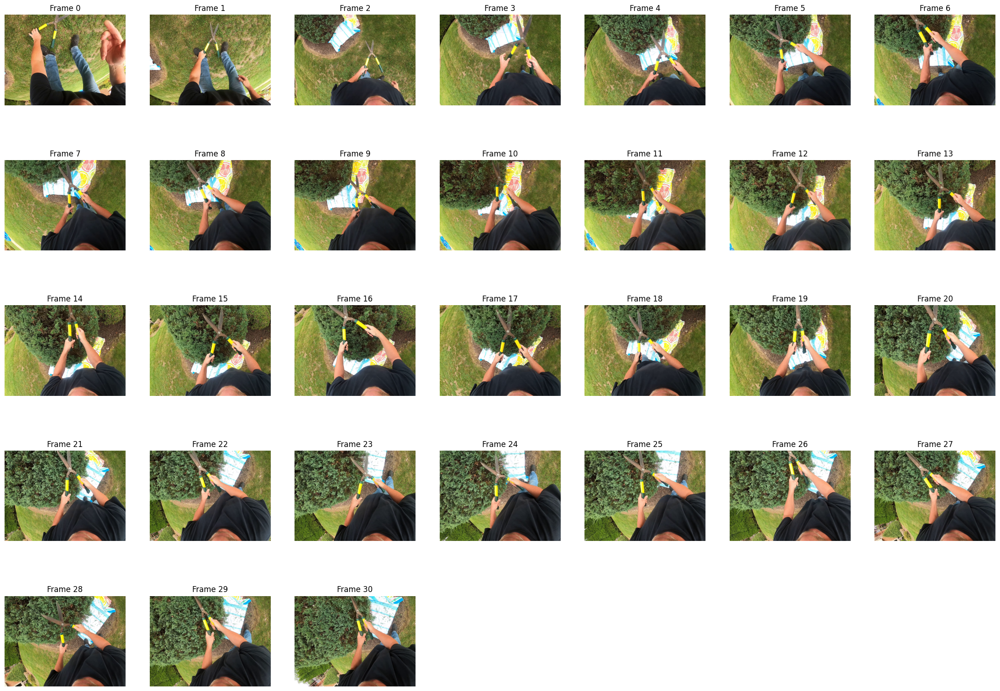

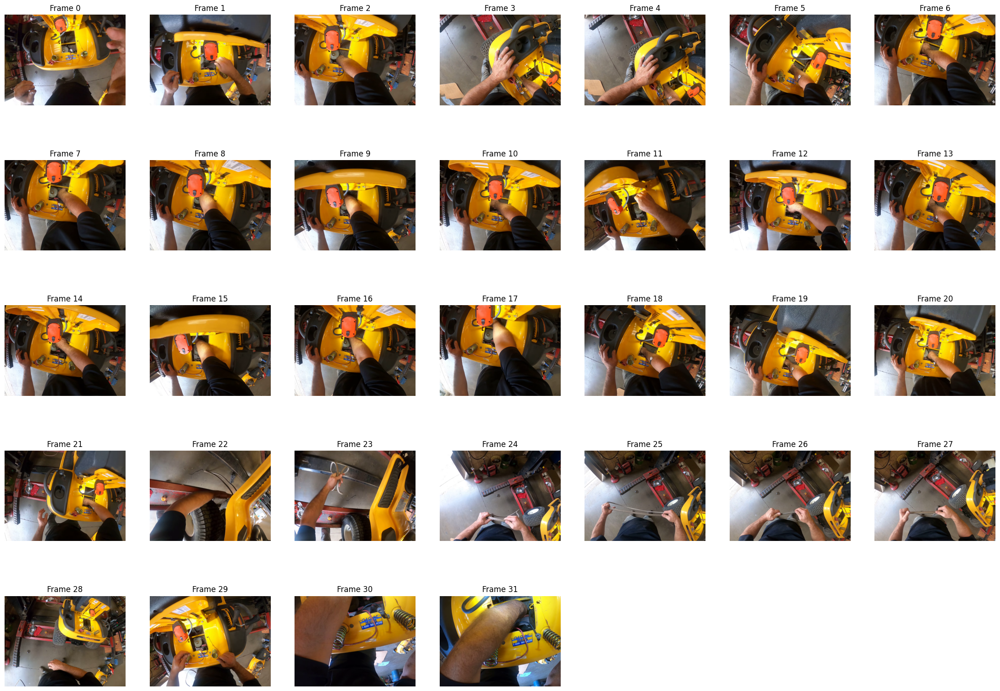

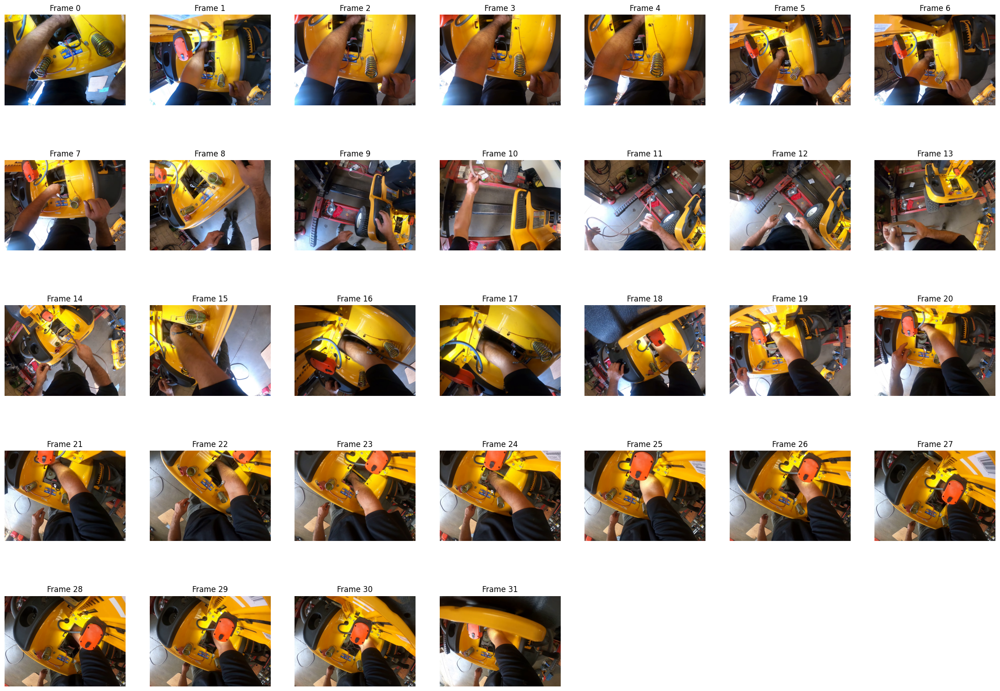

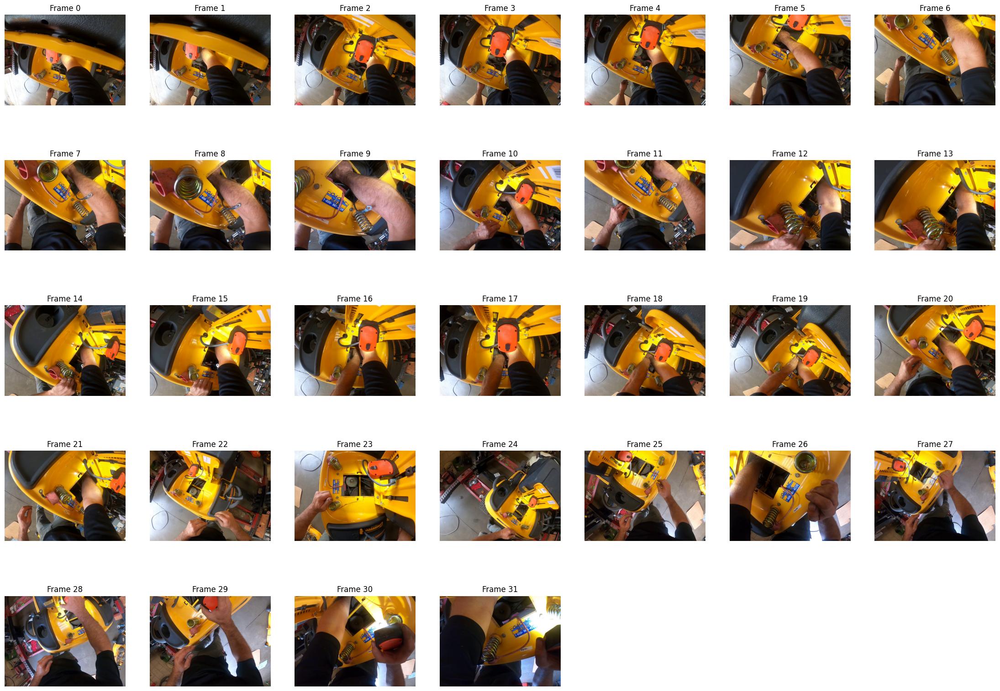

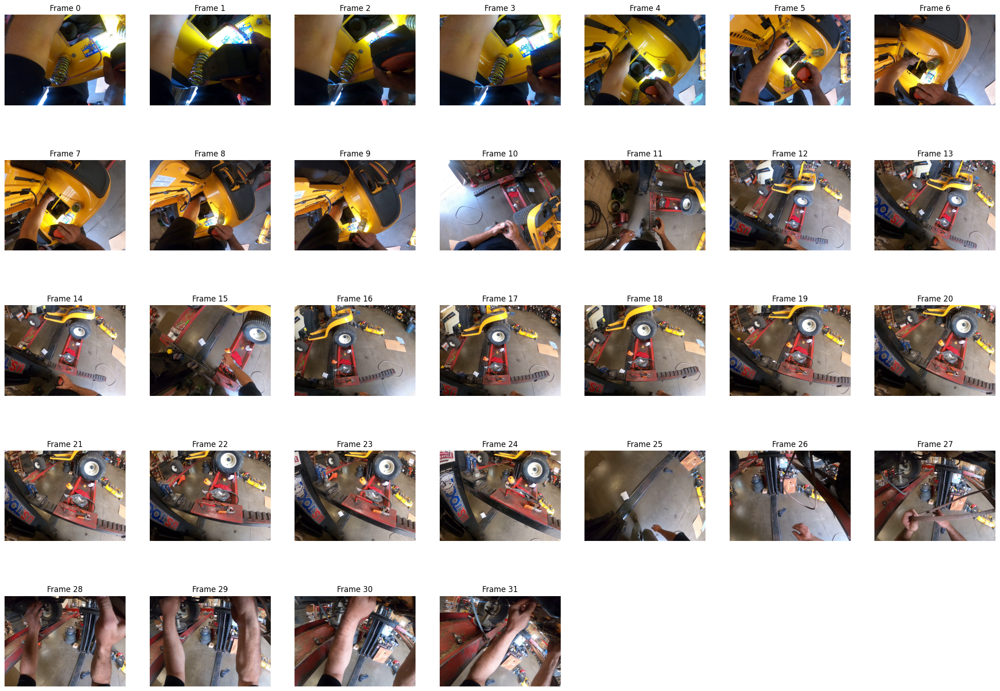

...

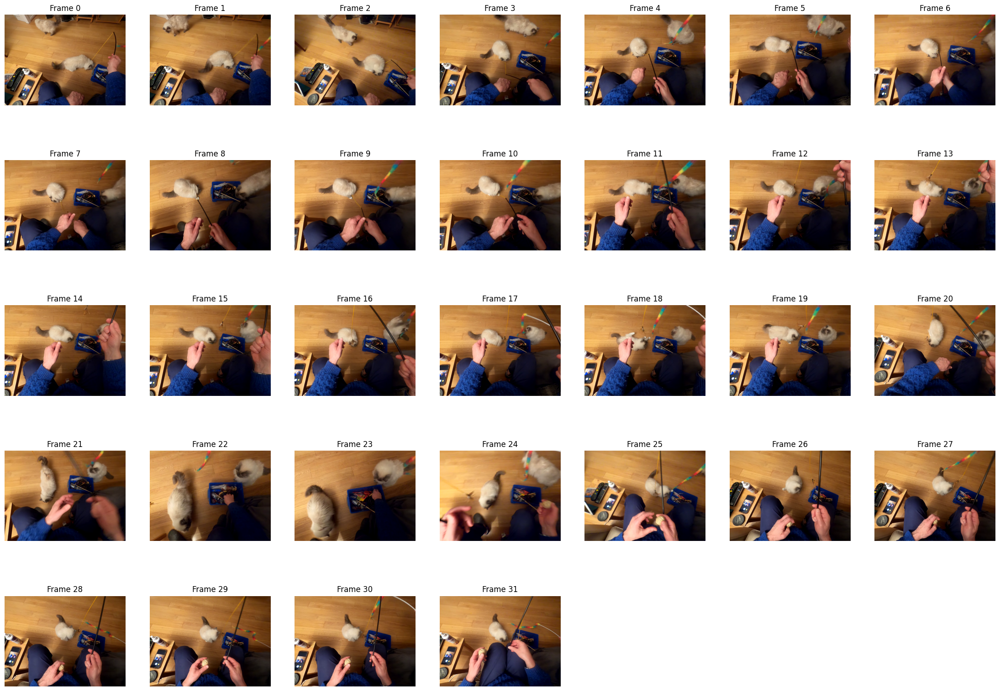

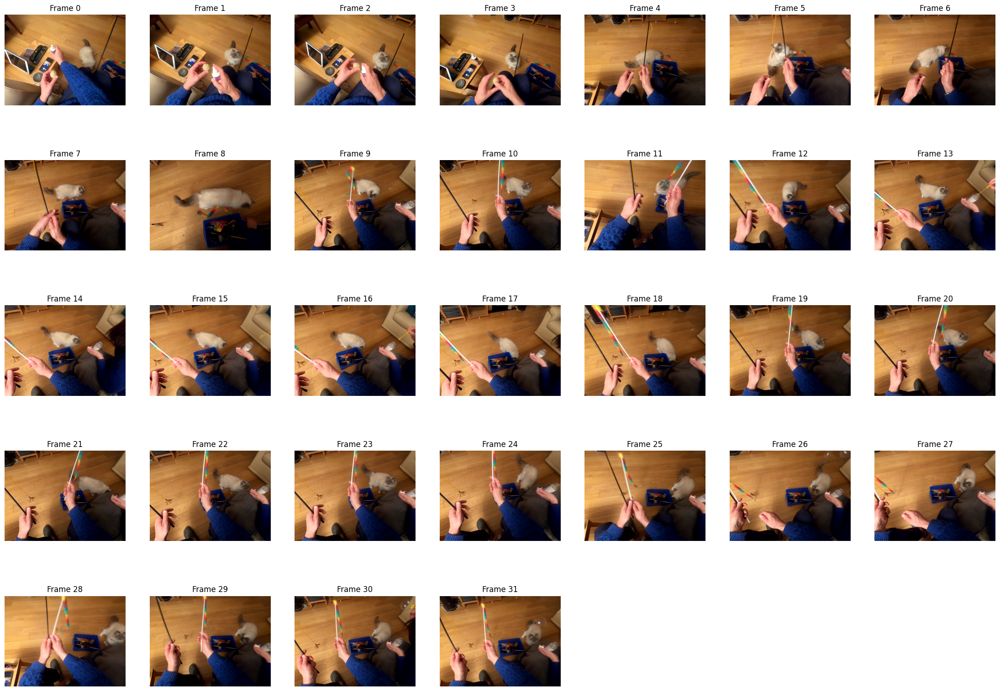

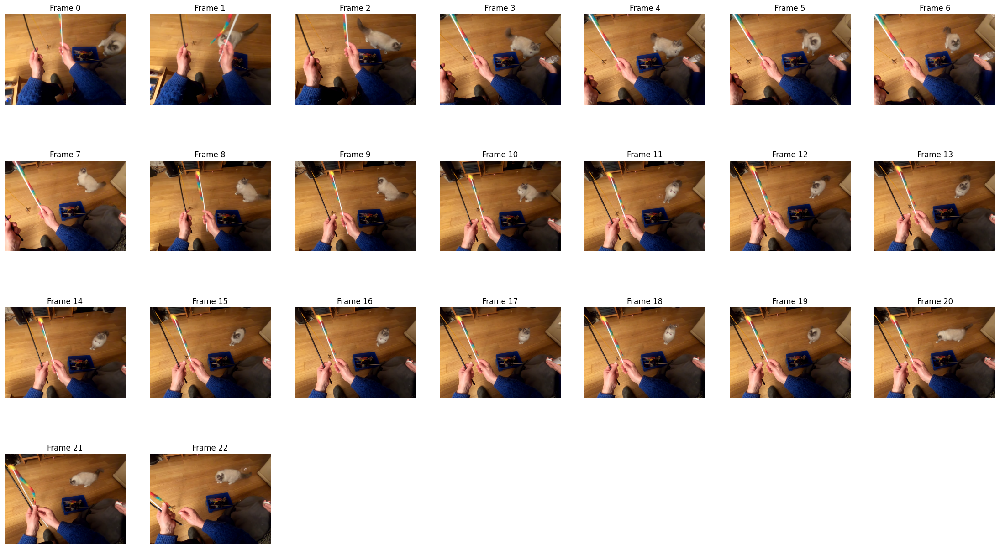

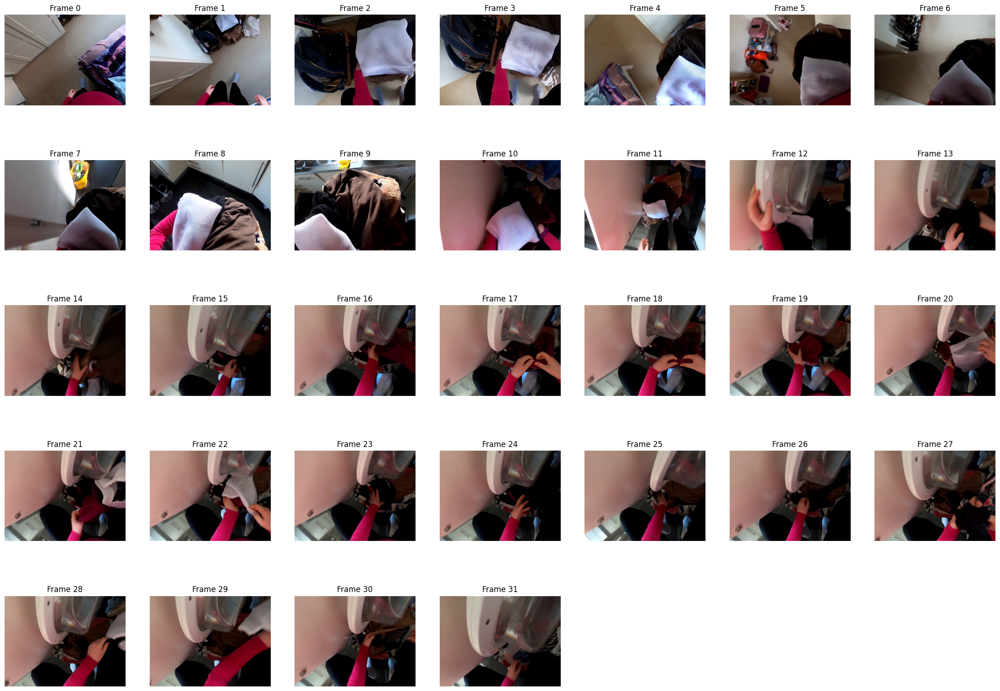

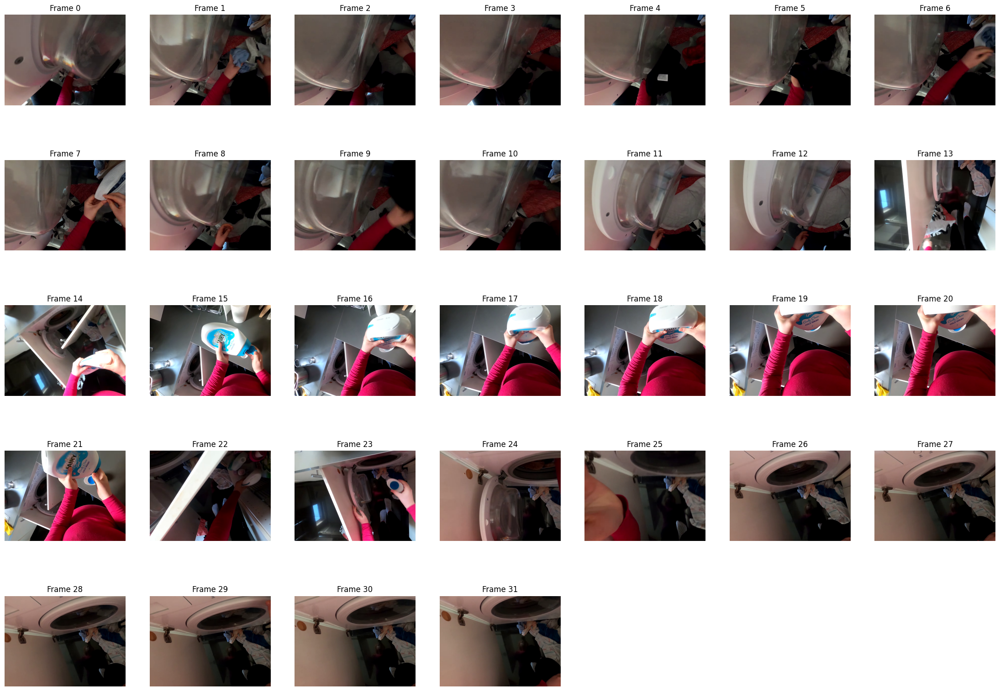

In [10]:
def des_object(path, clip_idx, action_idx, subject,output_dir='tmp1'):
    clip_id = list(anno_data[path].keys())[clip_idx]
    os.makedirs(f'{output_dir}/{path}/{clip_id}', exist_ok=True)
    action_narration, frames, stamp_time, start_time, end_time, load_range = load_action_clip(path, clip_idx, action_idx)

    show_image(load_range, frames, f'{output_dir}/{path}/{clip_id}/{action_idx}.png')

    question, answer = get_caption(model, tokenizer, action_narration, frames,
                                      '/root/videollm-online/data/preprocess/caption/prompt_streamingbenchv2.txt', subject)

    with open(f'{output_dir}/{path}/{clip_id}/{action_idx}.txt', 'w') as f:
        f.write(question + '\n')
        f.write(answer)
    
def des_object_scene(path, clip_idx, subject, output_dir='tmp1'):
    clip_gen = load_scene_clip(path, clip_idx)
    for i, (frames, start_time, end_time, load_range) in enumerate(clip_gen):
        os.makedirs(f'{output_dir}/{path}/{clip_idx}', exist_ok=True)
        show_image(load_range, frames, f'{output_dir}/{path}/{clip_idx}/{i}.png')

        question, answer = get_caption(model, tokenizer, None, frames,
                                      '/root/videollm-online/data/preprocess/caption/prompt_streamingbenchv2.txt', subject)

        with open(f'{output_dir}/{path}/{clip_idx}/{i}.txt', 'w') as f:
            f.write(question + '\n')
            f.write(answer)
            
def des_object_scenev2(path, clip_idx, subject, output_dir='tmp1'):
     = load_scene_clipv2(path, clip_idx)
    for i, (frames, start_time, end_time, load_range) in enumerate(clip_gen):
        os.makedirs(f'{output_dir}/{path}/{clip_idx}', exist_ok=True)
        show_image(load_range, frames, f'{output_dir}/{path}/{clip_idx}/{i}.png')

        question, answer = get_caption(model, tokenizer, None, frames,
                                      '/root/videollm-online/data/preprocess/caption/prompt_streamingbenchv2.txt', subject)

        with open(f'{ouclip_gentput_dir}/{path}/{clip_idx}/{i}.txt', 'w') as f:
            f.write(question + '\n')
            f.write(answer)


output_dir = 'tmp3'
os.makedirs(output_dir, exist_ok=True)
# frame_fps = 2
# VIDEO_ROOT = '/root/videollm-online/datasets/ego4d/v2/full_scale_2fps_max384'
# for i, (path, _annotation_uid_narrations) in tqdm.tqdm(enumerate(anno_data.items())):
#     if path + '.mp4' not in os.listdir(VIDEO_ROOT):
#         continue
#     for clip_idx, (annotation_uid, narrations) in enumerate(_annotation_uid_narrations.items()):
#         for action_idx, narration in enumerate(narrations):
#             des_object(path, clip_idx, action_idx)
#         break
#     if i > 5:
#         break

# read txt file
video_uid_list = open('/root/videollm-online/data/preprocess/metafile/major2scene_case.txt').read().split('\n')
video2scene = json.load(open('/root/videollm-online/data/preprocess/metafile/video2scene.json'))

# for path in tqdm.tqdm(video_uid_list):
#     _annotation_uid_narrations = anno_data[path]
#     for clip_idx, (annotation_uid, narrations) in enumerate(_annotation_uid_narrations.items()):
#         for action_idx, narration in enumerate(narrations):
#             des_object(path, clip_idx, action_idx, ' / '.join(video2scene[path]), output_dir)
#         break

# for path in tqdm.tqdm(video_uid_list):
#     _annotation_uid_narrations = anno_data[path]
#     for clip_idx, (annotation_uid, narrations) in enumerate(_annotation_uid_narrations.items()):
#         des_object_scene(path, clip_idx, ' / '.join(video2scene[path]), output_dir)
#         break
    
for path in tqdm.tqdm(video_uid_list):
    _annotation_uid_narrations = anno_data[path]
    for clip_idx, (annotation_uid, narrations) in enumerate(_annotation_uid_narrations.items()):
        des_object_scenev2(path, clip_idx, ' / '.join(video2scene[path]), output_dir)
        break


